In [8]:
import numpy as np
import matplotlib.pyplot as plt
import os
import torch
%matplotlib inline

In [9]:
org_dir = "outputs/PEMS-BAY/origin/id_data_PEMS-BAY_ema_False_eps_0.001_mad_0.99_sit_300_/epoch"
wb_dir = "outputs/PEMS-BAY/wavebound/id_data_PEMS-BAY_ema_True_eps_1.0_mad_0.99_sit_10000_lr_0.0005/epoch"

In [10]:
# true 
with open(os.path.join(org_dir, "true.npy"), 'rb') as f:
    y = np.load(f)
# org
with open(os.path.join(org_dir, "pred.npy"), 'rb') as f:
    org = np.load(f)
# wb
with open(os.path.join(wb_dir, "pred.npy"), 'rb') as f:
    wb = np.load(f)

In [11]:
y.shape, org.shape, wb.shape

((10419, 325, 12), (10419, 325, 12), (10419, 325, 12))

In [14]:
from util import metric

for i in range(12):
    org_metrics = metric(torch.Tensor(org[:, :, i]), torch.Tensor(y[:, :, i]))
    wb_metrics  = metric(torch.Tensor(wb[:, :, i]), torch.Tensor(y[:, :, i]))
    print(f"step {i+1} || org | MAE {org_metrics[0]:.4f} MAPE {org_metrics[1]:.4f} RMSE {org_metrics[2]:.4f} | ")
    print(f"step {i+1} || wb  | MAE {wb_metrics[0]:.4f} MAPE {wb_metrics[1]:.4f} RMSE {wb_metrics[2]:.4f} | ")

step 1 || org | MAE 0.8596 MAPE 0.0169 RMSE 1.5460 | 
step 1 || wb  | MAE 0.8449 MAPE 0.0162 RMSE 1.5358 | 
step 2 || org | MAE 1.1197 MAPE 0.0228 RMSE 2.2094 | 
step 2 || wb  | MAE 1.1108 MAPE 0.0223 RMSE 2.2092 | 
step 3 || org | MAE 1.3003 MAPE 0.0273 RMSE 2.7225 | 
step 3 || wb  | MAE 1.2917 MAPE 0.0269 RMSE 2.7221 | 
step 4 || org | MAE 1.4337 MAPE 0.0310 RMSE 3.1166 | 
step 4 || wb  | MAE 1.4252 MAPE 0.0305 RMSE 3.1166 | 
step 5 || org | MAE 1.5353 MAPE 0.0340 RMSE 3.4187 | 
step 5 || wb  | MAE 1.5265 MAPE 0.0335 RMSE 3.4189 | 
step 6 || org | MAE 1.6171 MAPE 0.0364 RMSE 3.6546 | 
step 6 || wb  | MAE 1.6080 MAPE 0.0359 RMSE 3.6538 | 
step 7 || org | MAE 1.6853 MAPE 0.0384 RMSE 3.8447 | 
step 7 || wb  | MAE 1.6750 MAPE 0.0379 RMSE 3.8397 | 
step 8 || org | MAE 1.7417 MAPE 0.0401 RMSE 3.9966 | 
step 8 || wb  | MAE 1.7310 MAPE 0.0397 RMSE 3.9883 | 
step 9 || org | MAE 1.7913 MAPE 0.0415 RMSE 4.1211 | 
step 9 || wb  | MAE 1.7797 MAPE 0.0412 RMSE 4.1114 | 
step 10 || org | MAE 1.8348 

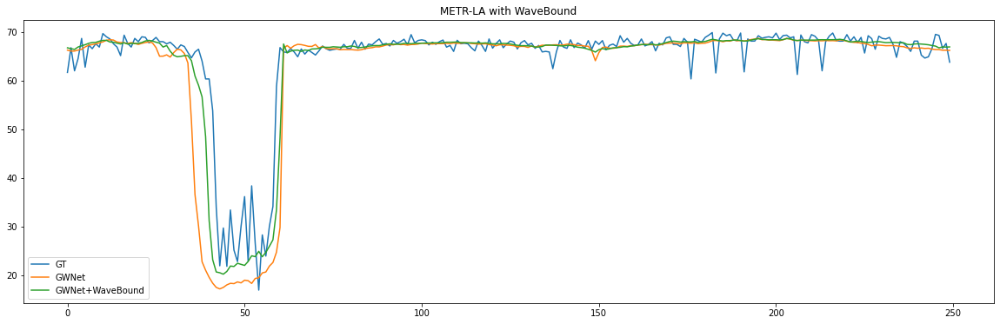

In [34]:
NODE = 2
step = 11
plt.figure(figsize=(20, 6))
s = 2000
e = 2250

plt.title(f"METR-LA with WaveBound")
plt.plot(y[s:e, NODE, step], label="GT")
plt.plot(org[s:e, NODE, step], label="GWNet")
plt.plot(wb[s:e, NODE, step], label="GWNet+WaveBound")
plt.legend()
plt.show()

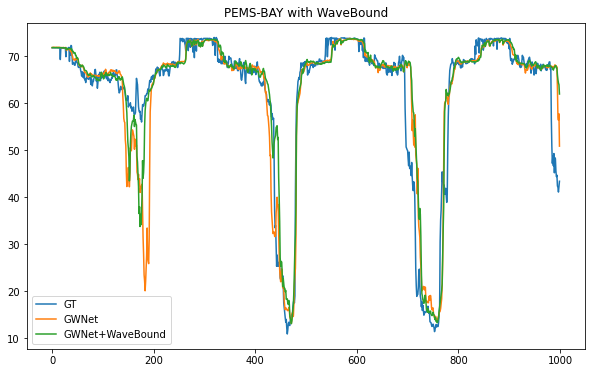

In [18]:
NODE = 311
step = 11
plt.figure(figsize=(10, 6))
s = 7000
e = 8000

plt.title(f"PEMS-BAY with WaveBound")
plt.plot(y[s:e, NODE, step], label="GT")
plt.plot(org[s:e, NODE, step], label="GWNet")
plt.plot(wb[s:e, NODE, step], label="GWNet+WaveBound")
plt.legend()
plt.show()

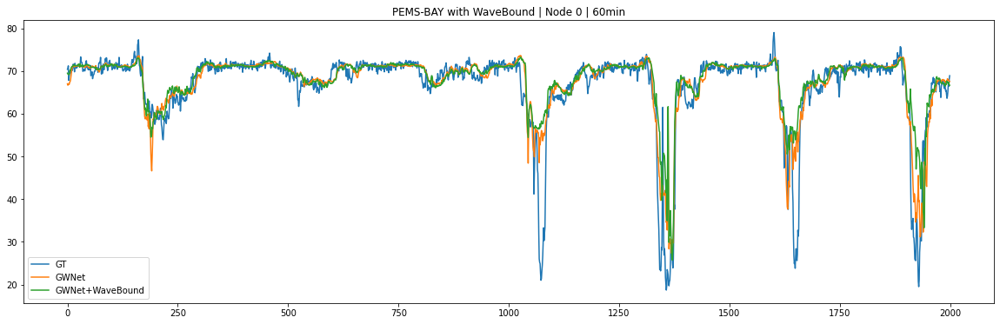

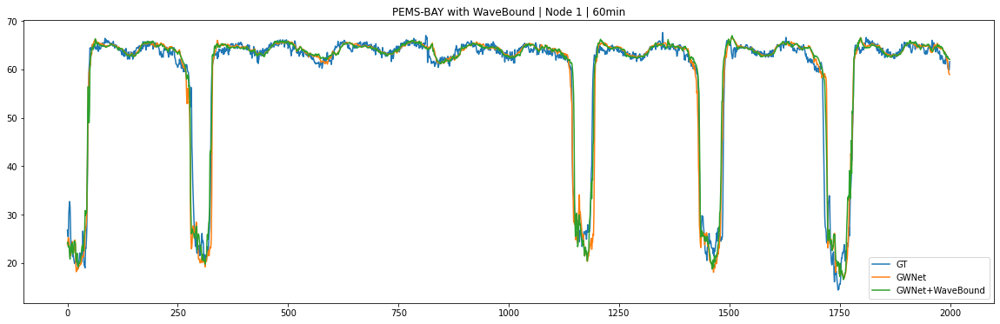

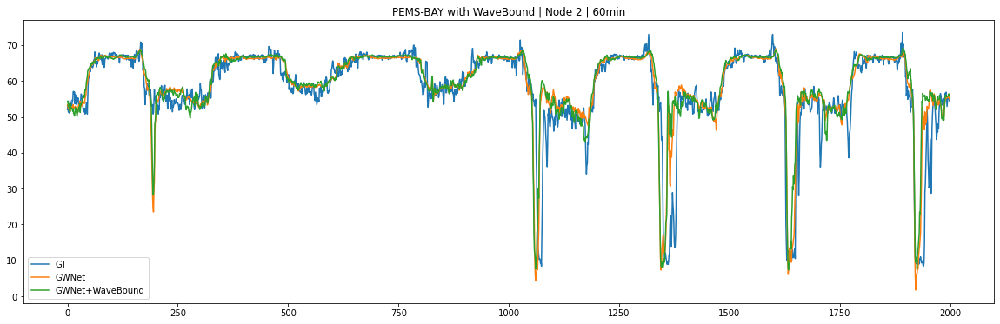

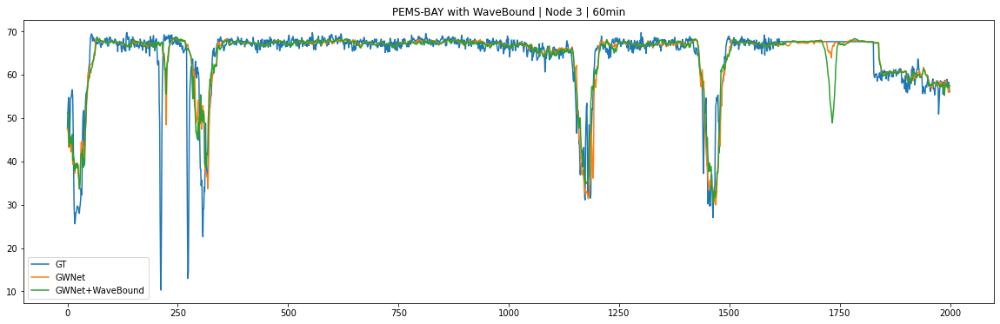

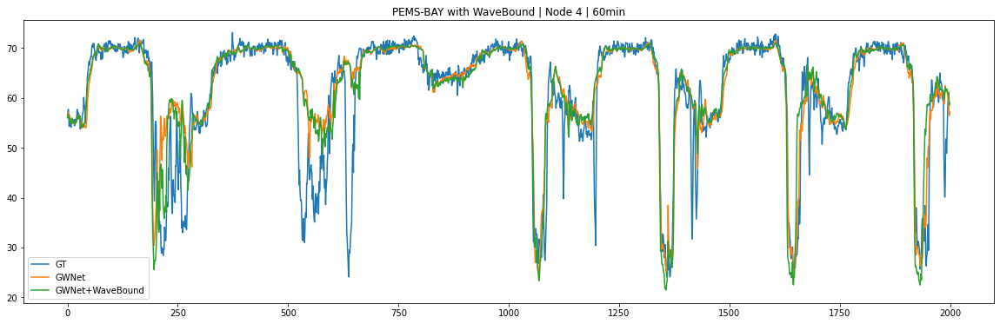

...

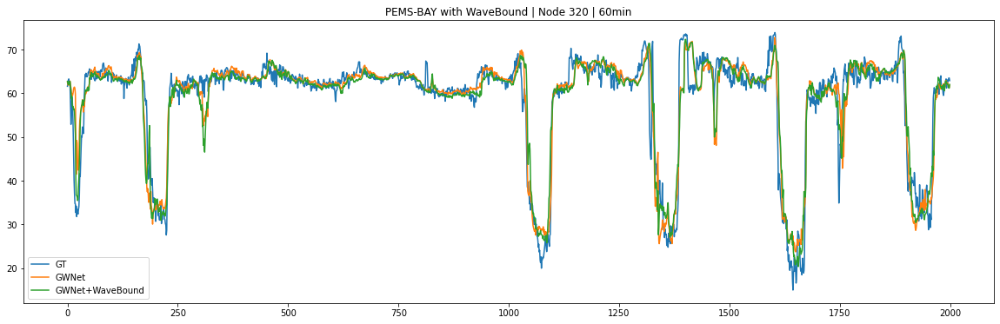

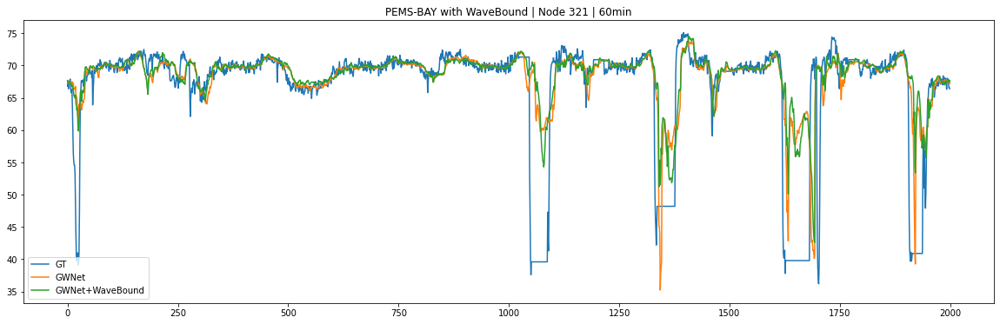

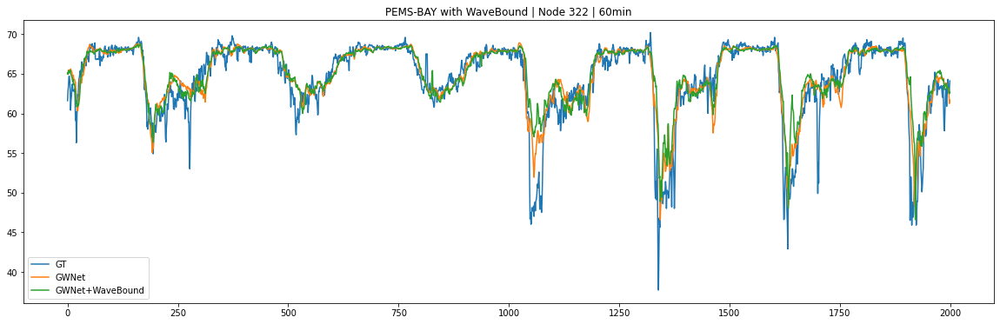

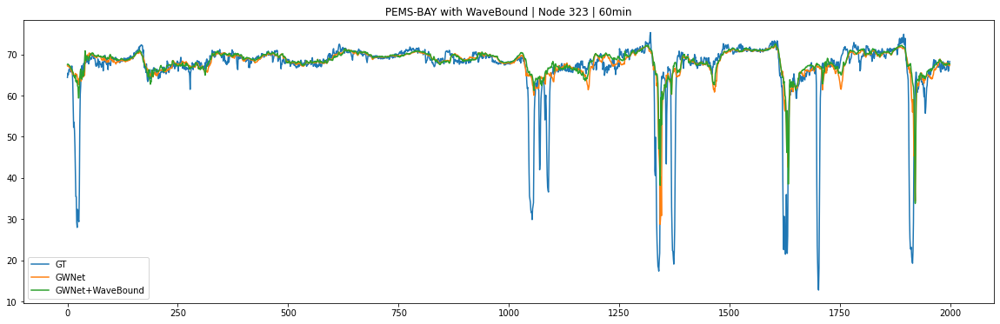

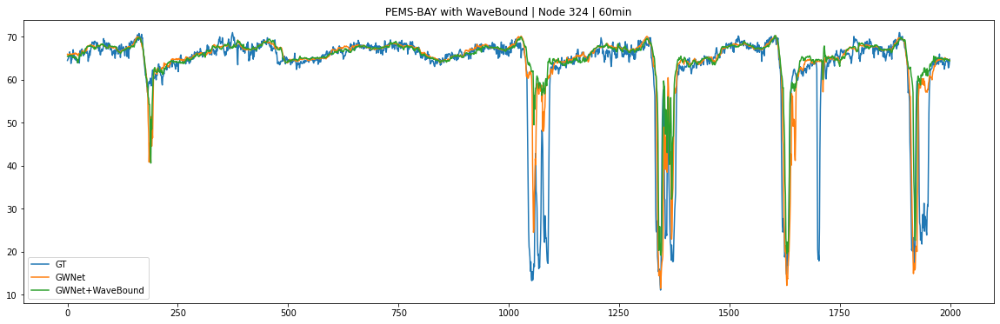

In [21]:
NODE = 2
step = 11

s = 6000
e = 8000

for n in range(325):
    plt.figure(figsize=(20, 6))
    NODE = n
    plt.title(f"PEMS-BAY with WaveBound | Node {NODE} | {(step+1)*5}min")
    plt.plot(y[s:e, NODE, step], label="GT")
    plt.plot(org[s:e, NODE, step], label="GWNet")
    plt.plot(wb[s:e, NODE, step], label="GWNet+WaveBound")
    plt.legend()
    plt.show()